In [1]:
!mkdir -p ~/.kaggle

In [2]:
!kaggle datasets download -d soumikrakshit/anime-faces

Dataset URL: https://www.kaggle.com/datasets/soumikrakshit/anime-faces
License(s): unknown
100% 439M/441M [00:27<00:00, 17.6MB/s]
100% 441M/441M [00:27<00:00, 16.6MB/s]


In [3]:
import zipfile
zip_ref = zipfile.ZipFile('/content/anime-faces.zip', 'r')
zip_ref.extractall('/content/')
zip_ref.close()

In [4]:
import os
import numpy as np
import matplotlib.pyplot as plt
import warnings
from tqdm.notebook import tqdm  #  tqdm is a Python library for adding progress bar

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras.preprocessing.image import load_img, array_to_img
from tensorflow.keras.models import Sequential, Model
from tensorflow.keras import layers
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import BinaryCrossentropy

warnings.filterwarnings('ignore')

In [5]:
BASE_DIR = '/content/data'

In [6]:
# load complete image paths to the list
image_paths = []
for image_name in os.listdir(BASE_DIR):
    image_path = os.path.join(BASE_DIR, image_name)
    image_paths.append(image_path)

In [7]:
len(image_paths)

21552

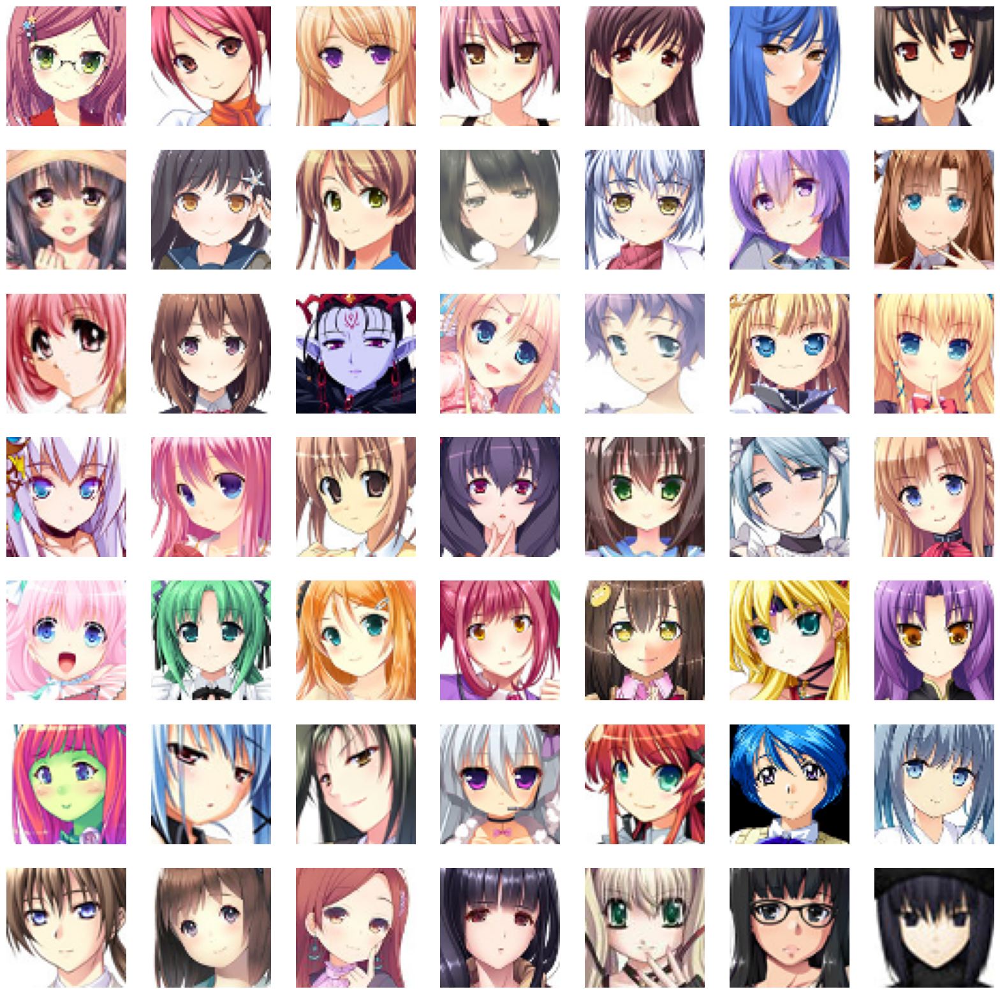

In [8]:
# to display grid of images (7x7)
plt.figure(figsize=(20, 20))
temp_images = image_paths[:49]
index = 1

for image_path in temp_images:
    plt.subplot(7, 7, index)
    # load the image
    img = load_img(image_path)
    # convert to numpy array
    img = np.array(img)
    # show the image
    plt.imshow(img)
    plt.axis('off')
    # increment the index for next image
    index += 1

In [9]:
# remove unnecessary file
image_paths.remove('/content/data/data')

In [10]:
from keras.preprocessing.image import load_img, img_to_array
# Define the target size for the images
target_size = (64, 64)

# Load and resize images, convert to numpy arrays
train_images = []
for path in tqdm(image_paths):
    img = load_img(path, target_size=target_size)
    img_array = img_to_array(img)
    train_images.append(img_array)

# Convert list of numpy arrays to a single numpy array
train_images = np.array(train_images)

  0%|          | 0/21551 [00:00<?, ?it/s]

In [11]:
train_images[0].shape

(64, 64, 3)

In [12]:
# reshape the array
train_images = train_images.reshape(train_images.shape[0], 64, 64, 3).astype('float32')

In [13]:
# normalize the images
train_images = (train_images - 127.5) / 127.5

In [14]:
train_images[0]

array([[[ 0.9843137 ,  1.        ,  0.9843137 ],
        [ 1.        ,  0.99215686,  0.99215686],
        [ 0.99215686,  0.9843137 ,  0.99215686],
        ...,
        [ 0.18431373, -0.29411766, -0.12941177],
        [ 0.78039217,  0.18431373,  0.23921569],
        [ 0.81960785,  0.15294118,  0.23137255]],

       [[ 0.9843137 ,  1.        ,  0.9843137 ],
        [ 1.        ,  0.99215686,  0.99215686],
        [ 0.96862745,  0.96862745,  0.9764706 ],
        ...,
        [ 0.8745098 ,  0.24705882,  0.41960785],
        [ 0.7254902 ,  0.1764706 ,  0.16862746],
        [ 0.77254903,  0.19215687,  0.16862746]],

       [[ 0.99215686,  1.        ,  0.9843137 ],
        [ 1.        ,  0.99215686,  0.99215686],
        [ 0.9843137 ,  0.99215686,  0.99215686],
        ...,
        [ 0.77254903,  0.16862746,  0.28627452],
        [ 0.77254903,  0.19215687,  0.25490198],
        [ 0.8039216 ,  0.16862746,  0.16078432]],

       ...,

       [[ 1.        ,  1.        ,  1.        ],
        [ 0

In [15]:
# latent dimension for random noise
LATENT_DIM = 100
# weight initializer
WEIGHT_INIT = keras.initializers.RandomNormal(mean=0.0, stddev=0.02)
# no. of channels of the image
CHANNELS = 3 # for gray scale, keep it as 1

In [16]:
model = Sequential(name='generator')

# 1d random noise
model.add(layers.Dense(8 * 8 * 512, input_dim=LATENT_DIM))
model.add(layers.ReLU())

# convert 1d to 3d
model.add(layers.Reshape((8, 8, 512)))

# upsample to 16x16
model.add(layers.Conv2DTranspose(256, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

# upsample to 32x32
model.add(layers.Conv2DTranspose(128, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

# upsample to 64x64
model.add(layers.Conv2DTranspose(64, (4, 4), strides=(2, 2), padding='same', kernel_initializer=WEIGHT_INIT))
model.add(layers.ReLU())

model.add(layers.Conv2D(CHANNELS, (4, 4), padding='same', activation='tanh'))

generator = model
generator.summary()

Model: "generator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 32768)             3309568   
                                                                 
 re_lu (ReLU)                (None, 32768)             0         
                                                                 
 reshape (Reshape)           (None, 8, 8, 512)         0         
                                                                 
 conv2d_transpose (Conv2DTr  (None, 16, 16, 256)       2097408   
 anspose)                                                        
                                                                 
 re_lu_1 (ReLU)              (None, 16, 16, 256)       0         
                                                                 
 conv2d_transpose_1 (Conv2D  (None, 32, 32, 128)       524416    
 Transpose)                                              

In [17]:
model = Sequential(name='discriminator')
input_shape = (64, 64, 3)
alpha = 0.2

# create conv layers
model.add(layers.Conv2D(64, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Conv2D(128, (4, 4), strides=(2, 2), padding='same', input_shape=input_shape))
model.add(layers.BatchNormalization())
model.add(layers.LeakyReLU(alpha=alpha))

model.add(layers.Flatten())
model.add(layers.Dropout(0.3))

# output class
model.add(layers.Dense(1, activation='sigmoid'))

discriminator = model
discriminator.summary()

Model: "discriminator"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_1 (Conv2D)           (None, 32, 32, 64)        3136      
                                                                 
 batch_normalization (Batch  (None, 32, 32, 64)        256       
 Normalization)                                                  
                                                                 
 leaky_re_lu (LeakyReLU)     (None, 32, 32, 64)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 16, 16, 128)       131200    
                                                                 
 batch_normalization_1 (Bat  (None, 16, 16, 128)       512       
 chNormalization)                                                
                                                                 
 leaky_re_lu_1 (LeakyReLU)   (None, 16, 16, 128)     

In [18]:
#DCGAN

class DCGAN(keras.Model):
    def __init__(self, generator, discriminator, latent_dim):
        super().__init__()
        self.generator = generator
        self.discriminator = discriminator
        self.latent_dim = latent_dim
        self.g_loss_metric = keras.metrics.Mean(name='g_loss')
        self.d_loss_metric = keras.metrics.Mean(name='d_loss')
        self.d_accuracy_metric = keras.metrics.BinaryAccuracy(name='d_accuracy')
        self.g_accuracy_metric = keras.metrics.BinaryAccuracy(name='g_accuracy')

    @property
    def metrics(self):
        return [self.g_loss_metric, self.d_loss_metric, self.d_accuracy_metric, self.g_accuracy_metric]

    def compile(self, g_optimizer, d_optimizer, loss_fn):
        super(DCGAN, self).compile()
        self.g_optimizer = g_optimizer
        self.d_optimizer = d_optimizer
        self.loss_fn = loss_fn

    def train_step(self, real_images):
        batch_size = tf.shape(real_images)[0]
        random_noise = tf.random.normal(shape=(batch_size, self.latent_dim))

        # Train discriminator
        with tf.GradientTape() as tape:
            pred_real = self.discriminator(real_images, training=True)
            real_labels = tf.ones((batch_size, 1)) * 0.9  # Smoothing for real labels
            d_loss_real = self.loss_fn(real_labels, pred_real)

            fake_images = self.generator(random_noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)
            fake_labels = tf.zeros((batch_size, 1))
            d_loss_fake = self.loss_fn(fake_labels, pred_fake)

            d_loss = (d_loss_real + d_loss_fake) / 2

            d_accuracy = self.d_accuracy_metric.update_state(tf.concat([tf.ones_like(pred_real), tf.zeros_like(pred_fake)], axis=0),
                                                             tf.concat([pred_real, pred_fake], axis=0))

        gradients = tape.gradient(d_loss, self.discriminator.trainable_variables)
        self.d_optimizer.apply_gradients(zip(gradients, self.discriminator.trainable_variables))

        # Train generator
        with tf.GradientTape() as tape:
            fake_images = self.generator(random_noise, training=True)
            pred_fake = self.discriminator(fake_images, training=True)
            labels = tf.ones((batch_size, 1))
            g_loss = self.loss_fn(labels, pred_fake)

            g_accuracy = self.g_accuracy_metric.update_state(tf.ones_like(pred_fake), pred_fake)

        gradients = tape.gradient(g_loss, self.generator.trainable_variables)
        self.g_optimizer.apply_gradients(zip(gradients, self.generator.trainable_variables))

        # Update metrics
        self.d_loss_metric.update_state(d_loss)
        self.g_loss_metric.update_state(g_loss)

        return {'d_loss': self.d_loss_metric.result(),
                'g_loss': self.g_loss_metric.result(),
                'd_accuracy': self.d_accuracy_metric.result(),
                'g_accuracy': self.g_accuracy_metric.result()}


In [19]:
# we will plot some images for each epoch

class DCGANMonitor(keras.callbacks.Callback):
    def __init__(self, num_imgs=25, latent_dim=100, output_dir='/content/drive/MyDrive/outputs'):
        self.num_imgs = num_imgs
        self.latent_dim = latent_dim
        self.output_dir = output_dir
        os.makedirs(self.output_dir, exist_ok=True)
        # create random noise for generating images
        self.noise = tf.random.normal([25, latent_dim])

    def on_epoch_end(self, epoch, logs=None):
        # generate the image from noise
        g_img = self.model.generator(self.noise)
        # denormalize the image
        g_img = (g_img * 127.5) + 127.5
        g_img.numpy()

        fig = plt.figure(figsize=(8, 8))
        for i in range(self.num_imgs):
            plt.subplot(5, 5, i+1)
            img = array_to_img(g_img[i])
            plt.imshow(img)
            plt.axis('off')
        file_path = os.path.join(self.output_dir, 'epoch_{:03d}.png'.format(epoch))
        plt.savefig(file_path)
        plt.show()

    def on_train_end(self, logs=None):
        model_path = os.path.join(self.output_dir, 'generator.h5')
        self.model.generator.save(model_path)

In [20]:
# initialize the DCGAN model
dcgan = DCGAN(generator=generator, discriminator=discriminator, latent_dim=LATENT_DIM)

In [21]:
# compile the DCGAN model
D_LR = 0.0001
G_LR = 0.0003
dcgan.compile(g_optimizer=Adam(learning_rate=G_LR, beta_1=0.5), d_optimizer=Adam(learning_rate=D_LR, beta_1=0.5), loss_fn=BinaryCrossentropy())

Epoch 1/30
674/674 [==============================] - ETA: 0s - d_loss: 0.8792 - g_loss: 2.6534 - d_accuracy: 0.7108 - g_accuracy: 0.1206

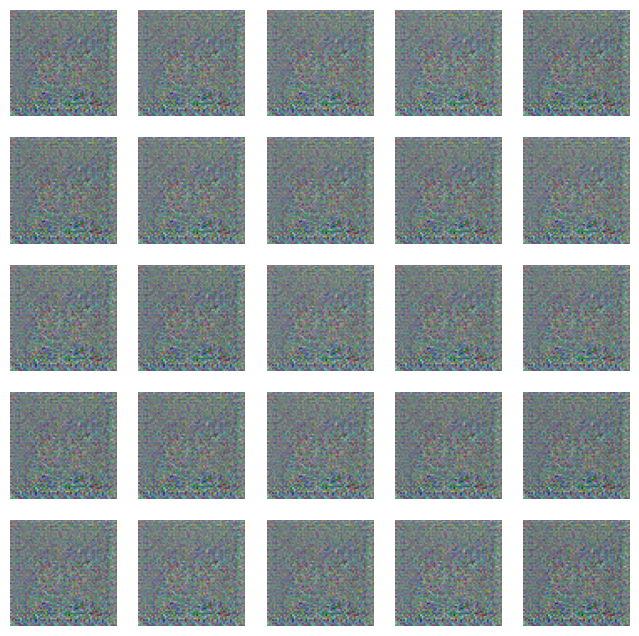

674/674 [==============================] - 58s 67ms/step - d_loss: 0.8792 - g_loss: 2.6534 - d_accuracy: 0.7108 - g_accuracy: 0.1206
Epoch 2/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.5057 - g_loss: 2.5107 - d_accuracy: 0.7898 - g_accuracy: 0.0419

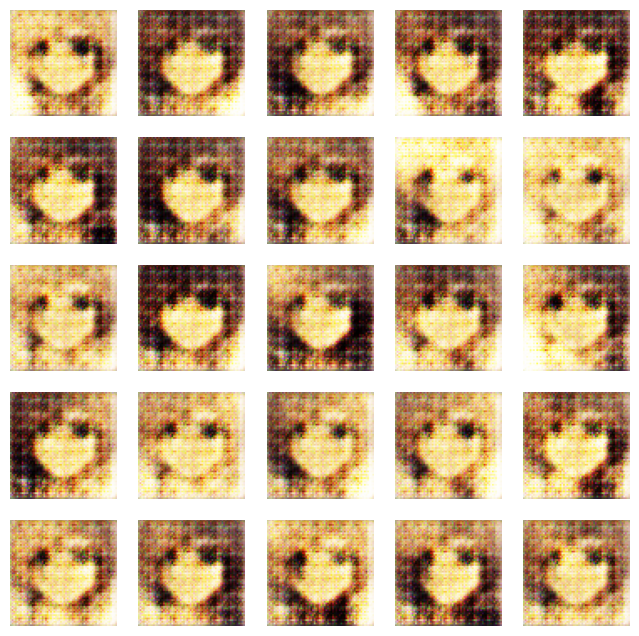

674/674 [==============================] - 44s 66ms/step - d_loss: 0.5058 - g_loss: 2.5091 - d_accuracy: 0.7898 - g_accuracy: 0.0419
Epoch 3/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6278 - g_loss: 1.6455 - d_accuracy: 0.6797 - g_accuracy: 0.0640

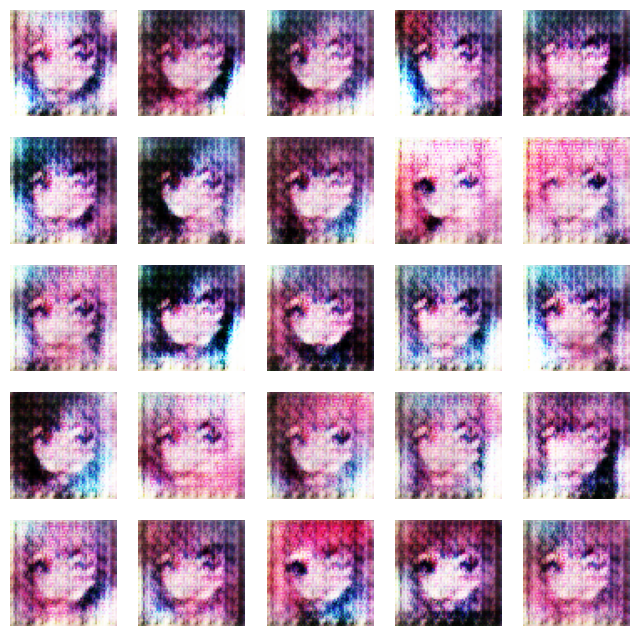

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6277 - g_loss: 1.6452 - d_accuracy: 0.6797 - g_accuracy: 0.0640
Epoch 4/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6280 - g_loss: 1.6512 - d_accuracy: 0.6693 - g_accuracy: 0.0680

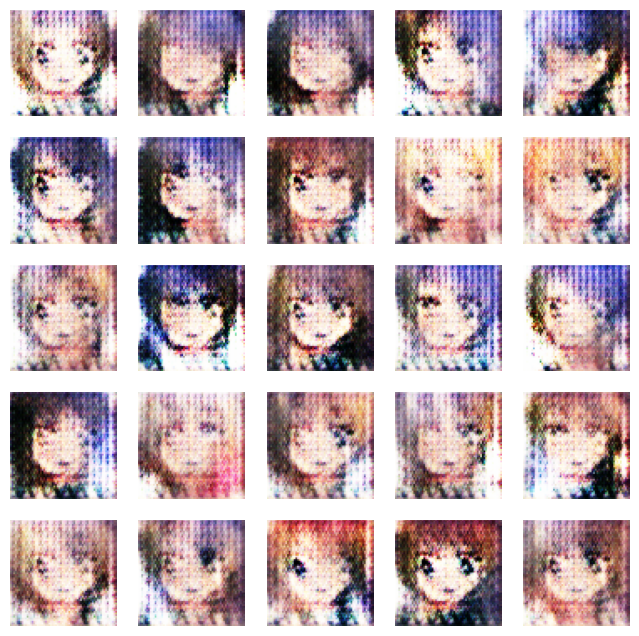

674/674 [==============================] - 44s 65ms/step - d_loss: 0.6281 - g_loss: 1.6506 - d_accuracy: 0.6692 - g_accuracy: 0.0680
Epoch 5/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6401 - g_loss: 1.6043 - d_accuracy: 0.6533 - g_accuracy: 0.0641

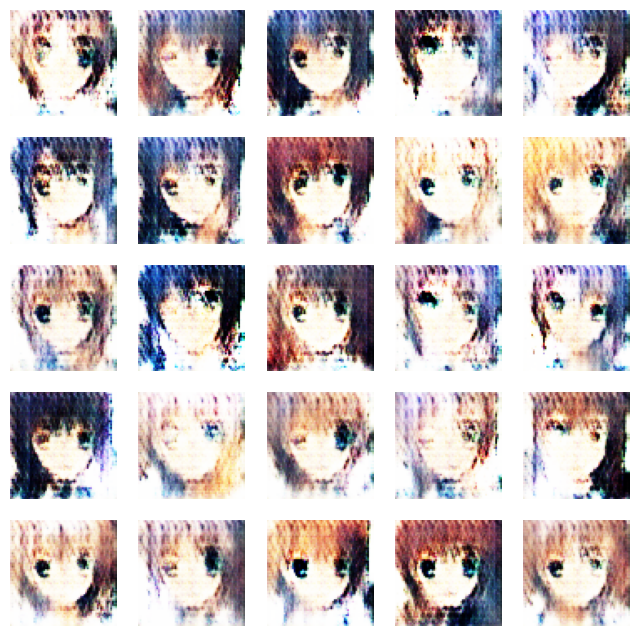

674/674 [==============================] - 45s 66ms/step - d_loss: 0.6401 - g_loss: 1.6044 - d_accuracy: 0.6532 - g_accuracy: 0.0640
Epoch 6/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6259 - g_loss: 1.6067 - d_accuracy: 0.6653 - g_accuracy: 0.0528

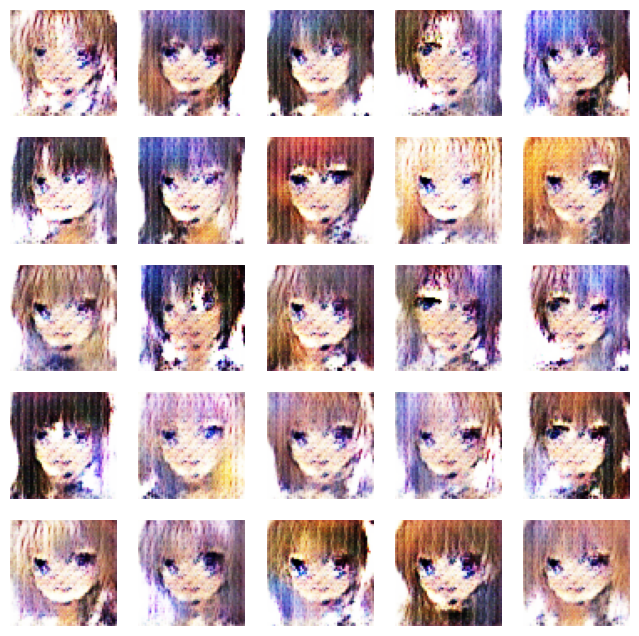

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6259 - g_loss: 1.6071 - d_accuracy: 0.6653 - g_accuracy: 0.0528
Epoch 7/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6367 - g_loss: 1.5036 - d_accuracy: 0.6495 - g_accuracy: 0.0635

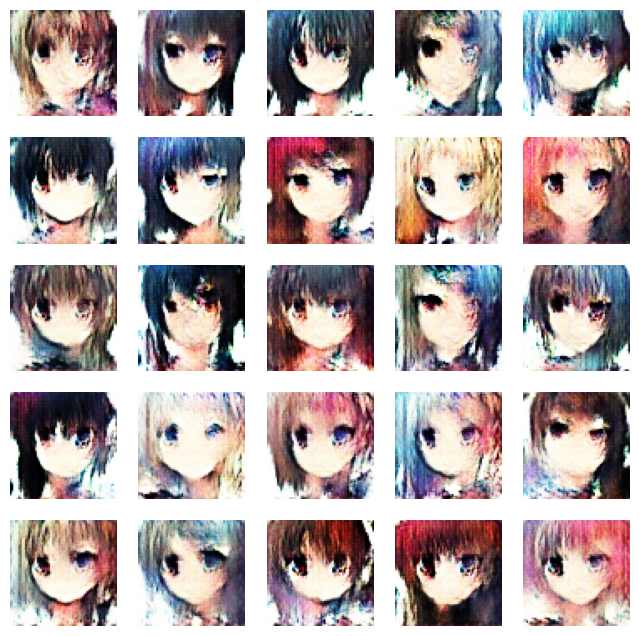

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6367 - g_loss: 1.5031 - d_accuracy: 0.6494 - g_accuracy: 0.0635
Epoch 8/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6540 - g_loss: 1.3168 - d_accuracy: 0.6243 - g_accuracy: 0.0929

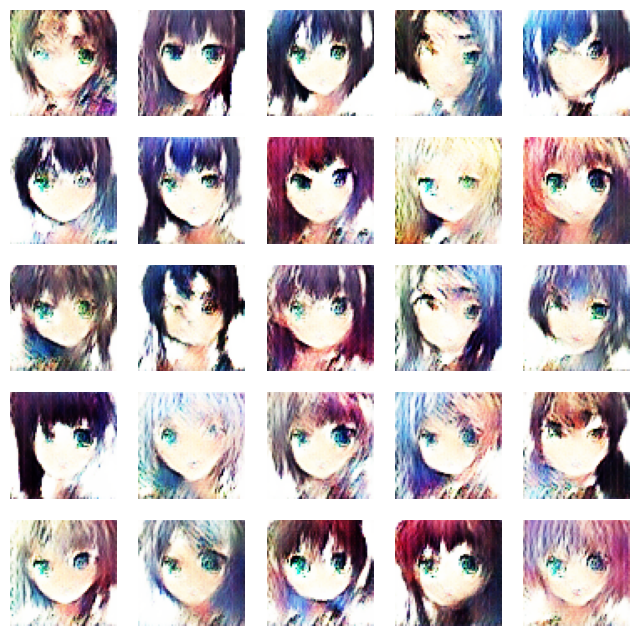

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6540 - g_loss: 1.3167 - d_accuracy: 0.6244 - g_accuracy: 0.0928
Epoch 9/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6430 - g_loss: 1.3087 - d_accuracy: 0.6360 - g_accuracy: 0.0897

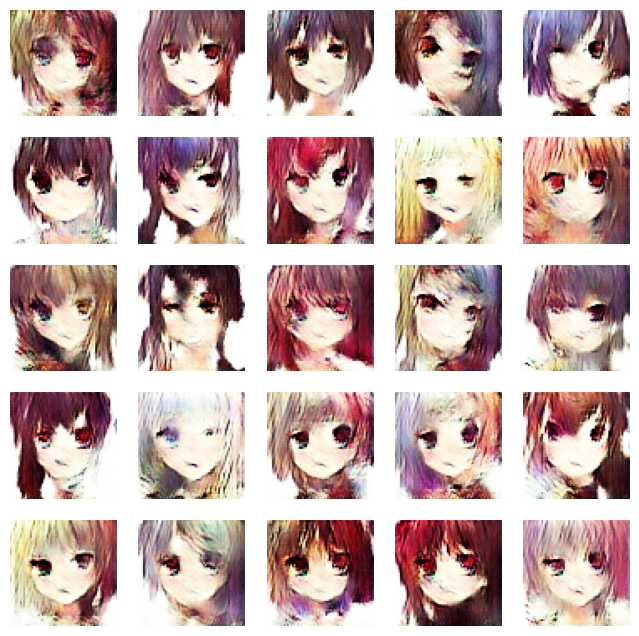

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6431 - g_loss: 1.3086 - d_accuracy: 0.6360 - g_accuracy: 0.0896
Epoch 10/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6840 - g_loss: 1.1478 - d_accuracy: 0.5791 - g_accuracy: 0.1391

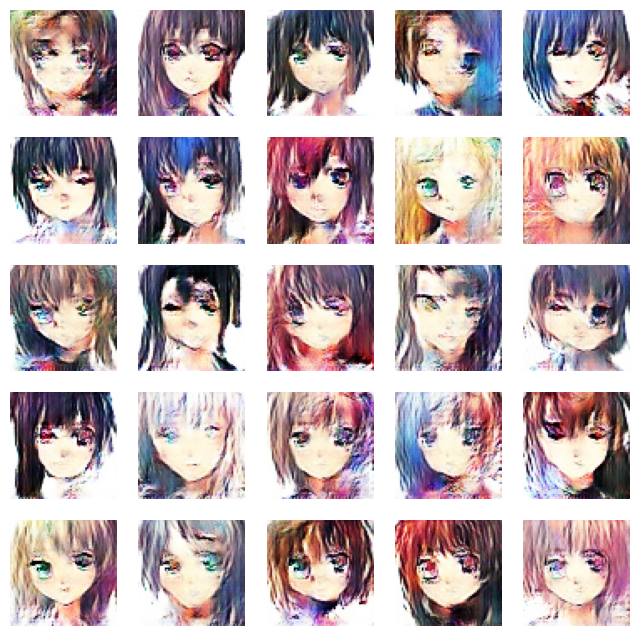

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6838 - g_loss: 1.1479 - d_accuracy: 0.5793 - g_accuracy: 0.1391
Epoch 11/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.7078 - g_loss: 1.0331 - d_accuracy: 0.5359 - g_accuracy: 0.1736

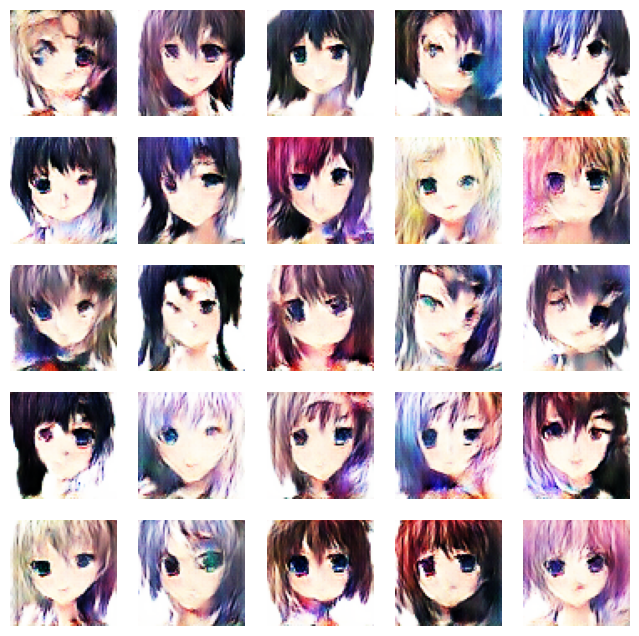

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7078 - g_loss: 1.0330 - d_accuracy: 0.5359 - g_accuracy: 0.1736
Epoch 12/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.7085 - g_loss: 0.9889 - d_accuracy: 0.5265 - g_accuracy: 0.1789

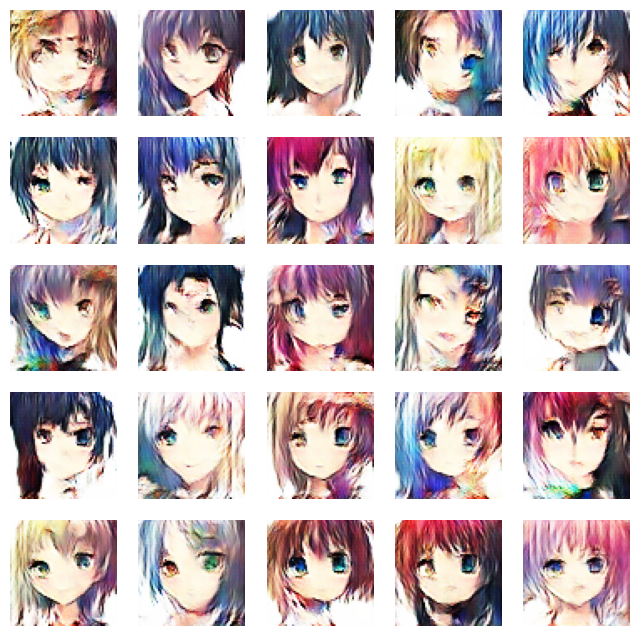

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7086 - g_loss: 0.9891 - d_accuracy: 0.5265 - g_accuracy: 0.1788
Epoch 13/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.7097 - g_loss: 0.9488 - d_accuracy: 0.5189 - g_accuracy: 0.1889

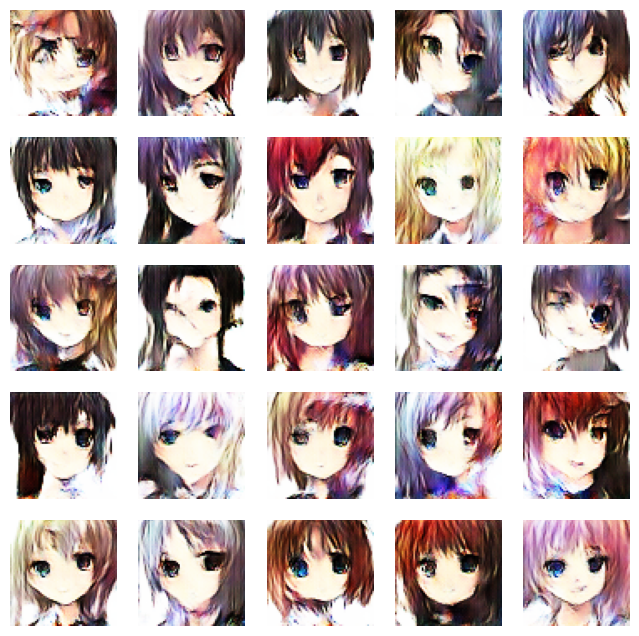

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7097 - g_loss: 0.9491 - d_accuracy: 0.5189 - g_accuracy: 0.1889
Epoch 14/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.7081 - g_loss: 0.9258 - d_accuracy: 0.5117 - g_accuracy: 0.1906

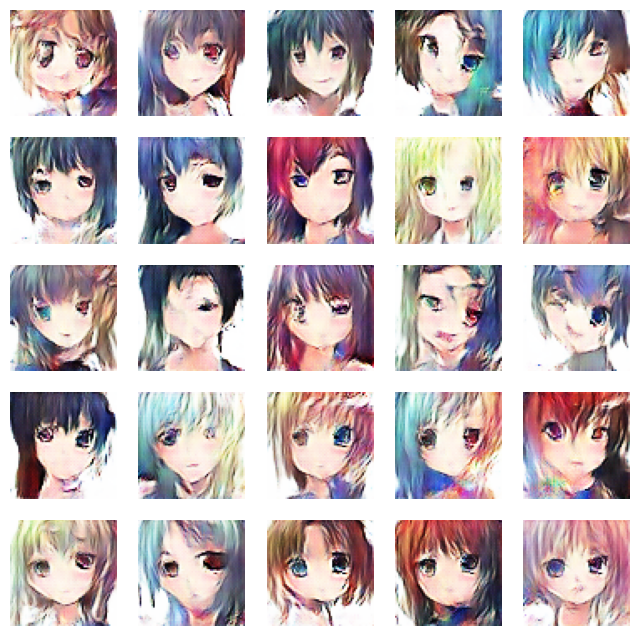

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7081 - g_loss: 0.9258 - d_accuracy: 0.5116 - g_accuracy: 0.1906
Epoch 15/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.7049 - g_loss: 0.9207 - d_accuracy: 0.5128 - g_accuracy: 0.1702

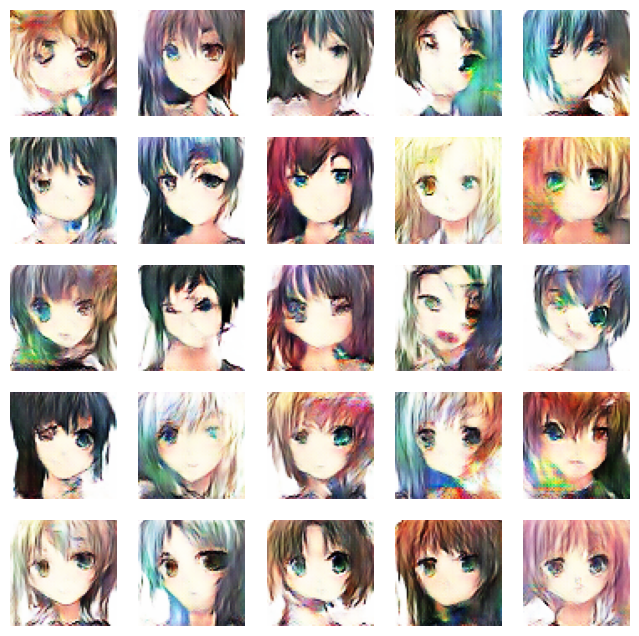

674/674 [==============================] - 45s 66ms/step - d_loss: 0.7048 - g_loss: 0.9206 - d_accuracy: 0.5129 - g_accuracy: 0.1702
Epoch 16/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.7032 - g_loss: 0.8962 - d_accuracy: 0.5083 - g_accuracy: 0.1744

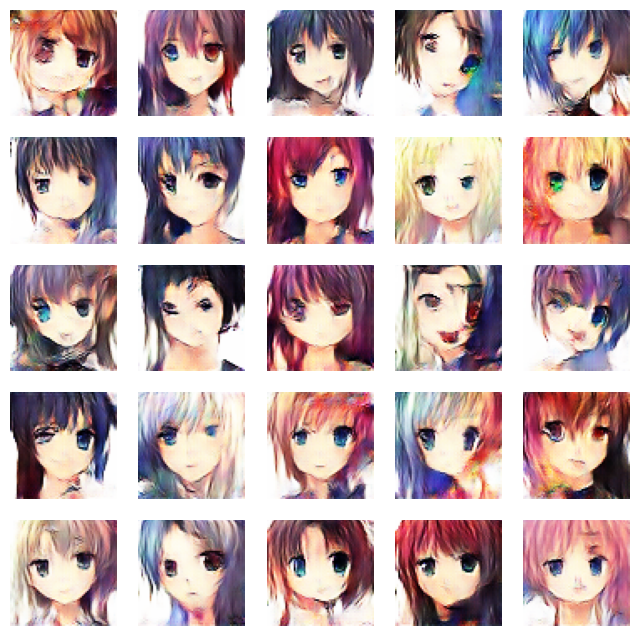

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7032 - g_loss: 0.8962 - d_accuracy: 0.5083 - g_accuracy: 0.1744
Epoch 17/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.7017 - g_loss: 0.8961 - d_accuracy: 0.5099 - g_accuracy: 0.1602

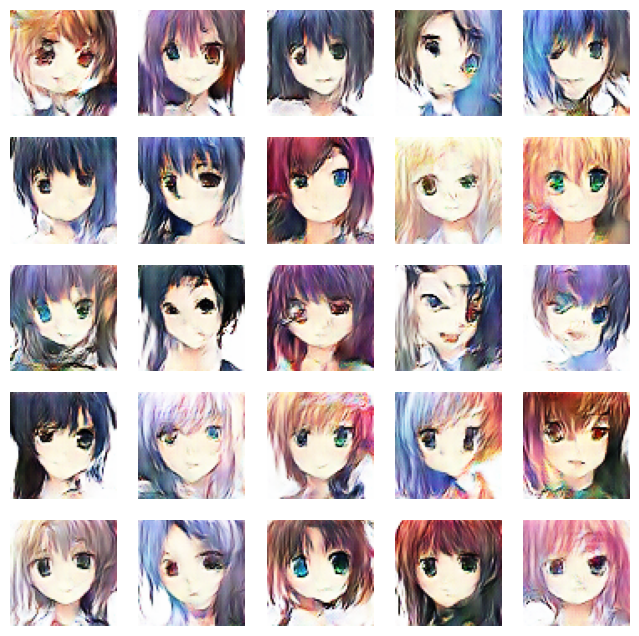

674/674 [==============================] - 45s 66ms/step - d_loss: 0.7016 - g_loss: 0.8961 - d_accuracy: 0.5099 - g_accuracy: 0.1603
Epoch 18/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6992 - g_loss: 0.8913 - d_accuracy: 0.5109 - g_accuracy: 0.1539

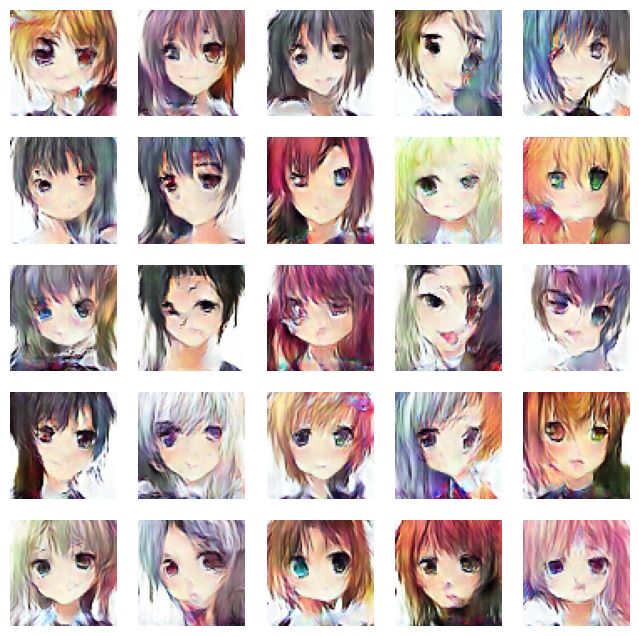

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6992 - g_loss: 0.8913 - d_accuracy: 0.5109 - g_accuracy: 0.1539
Epoch 19/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.7001 - g_loss: 0.8847 - d_accuracy: 0.5046 - g_accuracy: 0.1441

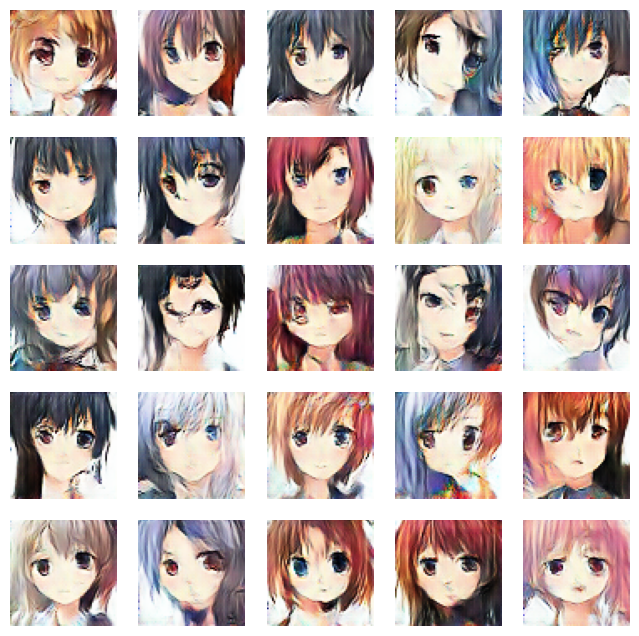

674/674 [==============================] - 45s 67ms/step - d_loss: 0.7000 - g_loss: 0.8847 - d_accuracy: 0.5046 - g_accuracy: 0.1441
Epoch 20/30
674/674 [==============================] - ETA: 0s - d_loss: 0.6980 - g_loss: 0.8780 - d_accuracy: 0.5071 - g_accuracy: 0.1361

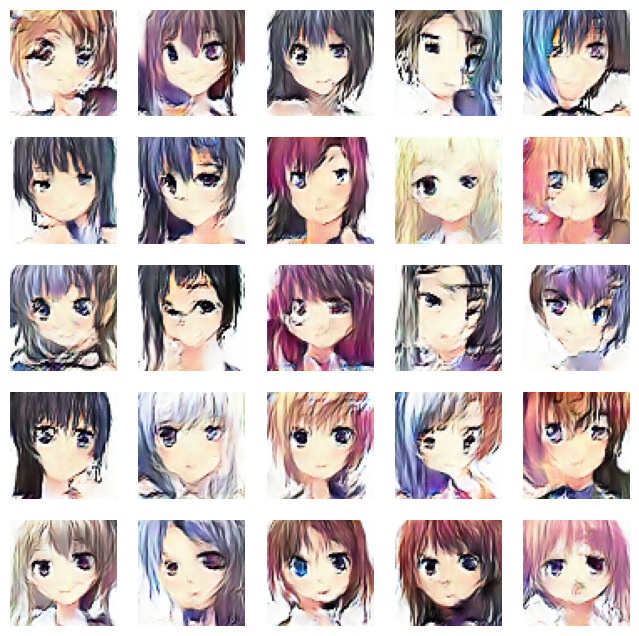

674/674 [==============================] - 52s 77ms/step - d_loss: 0.6980 - g_loss: 0.8780 - d_accuracy: 0.5071 - g_accuracy: 0.1361
Epoch 21/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6976 - g_loss: 0.8762 - d_accuracy: 0.5079 - g_accuracy: 0.1324

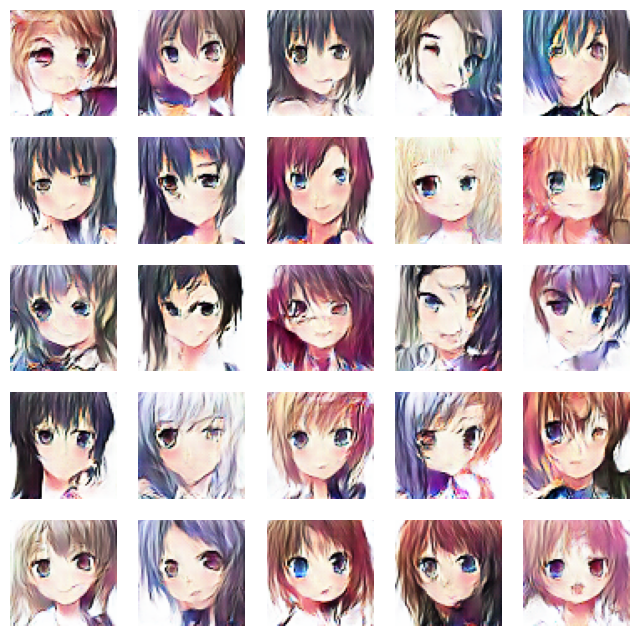

674/674 [==============================] - 46s 68ms/step - d_loss: 0.6976 - g_loss: 0.8762 - d_accuracy: 0.5078 - g_accuracy: 0.1323
Epoch 22/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6955 - g_loss: 0.8737 - d_accuracy: 0.5110 - g_accuracy: 0.1269

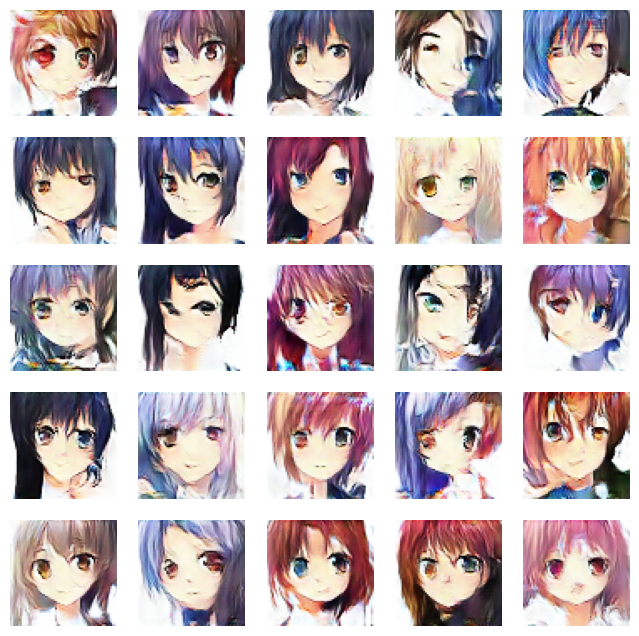

674/674 [==============================] - 44s 66ms/step - d_loss: 0.6955 - g_loss: 0.8738 - d_accuracy: 0.5109 - g_accuracy: 0.1268
Epoch 23/30
674/674 [==============================] - ETA: 0s - d_loss: 0.6942 - g_loss: 0.8709 - d_accuracy: 0.5129 - g_accuracy: 0.1214

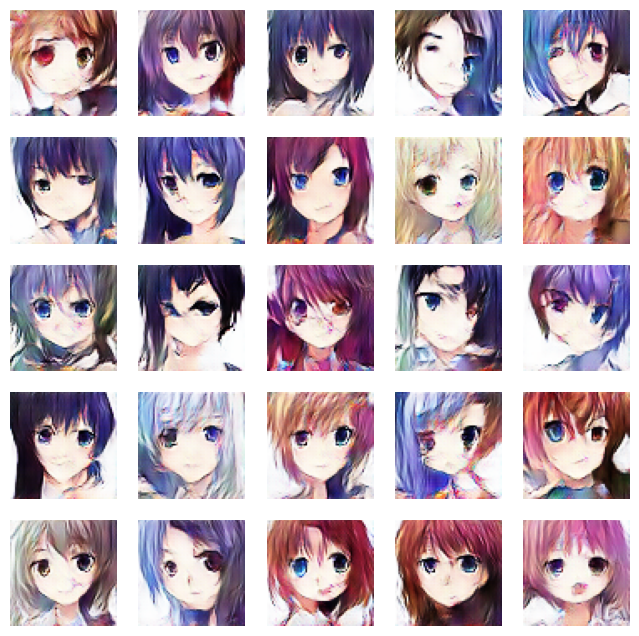

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6942 - g_loss: 0.8709 - d_accuracy: 0.5129 - g_accuracy: 0.1214
Epoch 24/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6929 - g_loss: 0.8790 - d_accuracy: 0.5154 - g_accuracy: 0.1140

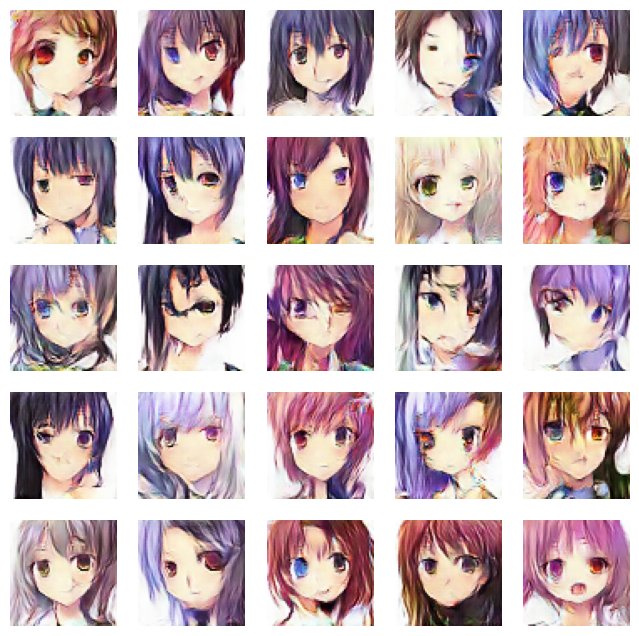

674/674 [==============================] - 45s 66ms/step - d_loss: 0.6928 - g_loss: 0.8790 - d_accuracy: 0.5154 - g_accuracy: 0.1140
Epoch 25/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6910 - g_loss: 0.8792 - d_accuracy: 0.5202 - g_accuracy: 0.1149

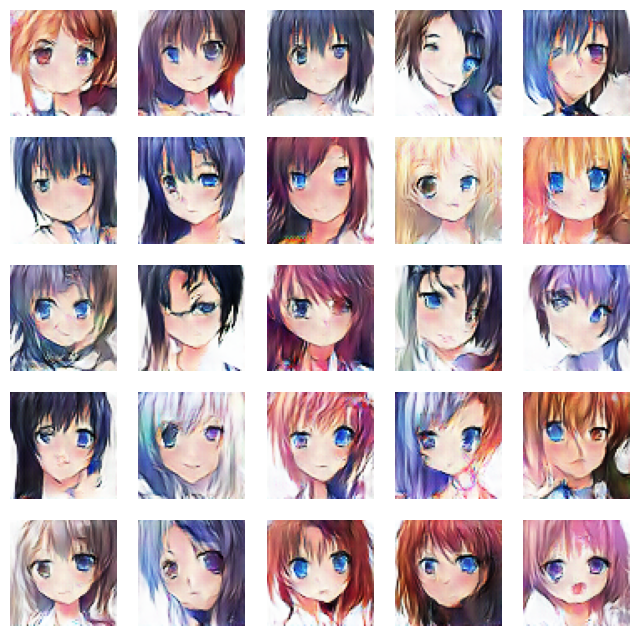

674/674 [==============================] - 45s 66ms/step - d_loss: 0.6909 - g_loss: 0.8793 - d_accuracy: 0.5202 - g_accuracy: 0.1148
Epoch 26/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6897 - g_loss: 0.8850 - d_accuracy: 0.5251 - g_accuracy: 0.1165

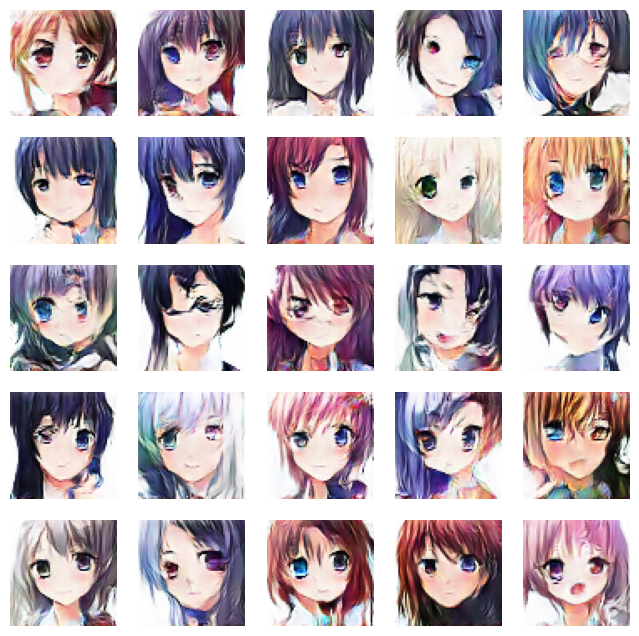

674/674 [==============================] - 45s 66ms/step - d_loss: 0.6896 - g_loss: 0.8850 - d_accuracy: 0.5252 - g_accuracy: 0.1165
Epoch 27/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6880 - g_loss: 0.8896 - d_accuracy: 0.5290 - g_accuracy: 0.1076

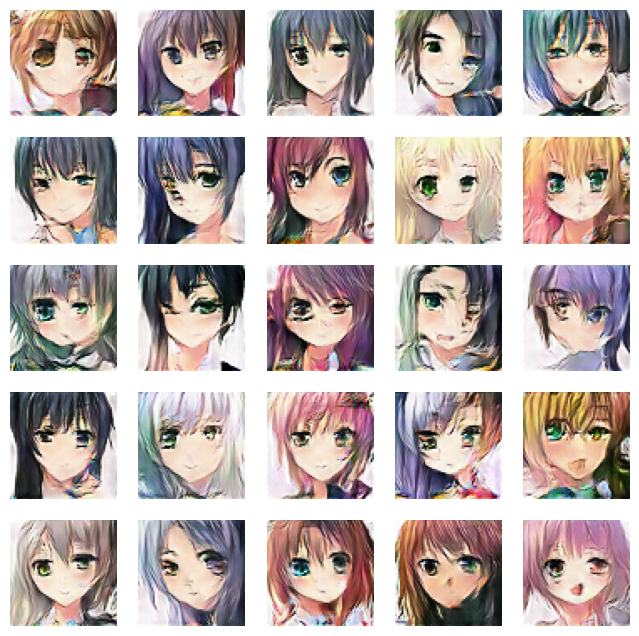

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6880 - g_loss: 0.8897 - d_accuracy: 0.5290 - g_accuracy: 0.1076
Epoch 28/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6854 - g_loss: 0.8943 - d_accuracy: 0.5363 - g_accuracy: 0.1067

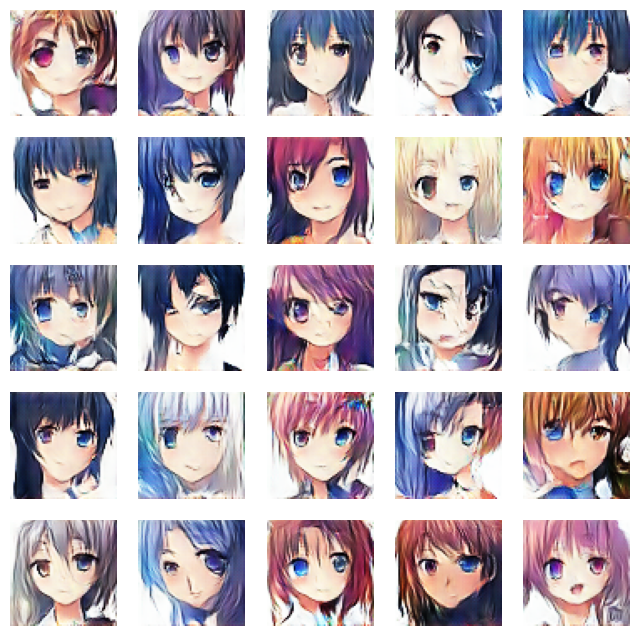

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6855 - g_loss: 0.8943 - d_accuracy: 0.5363 - g_accuracy: 0.1066
Epoch 29/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6854 - g_loss: 0.8971 - d_accuracy: 0.5370 - g_accuracy: 0.1120

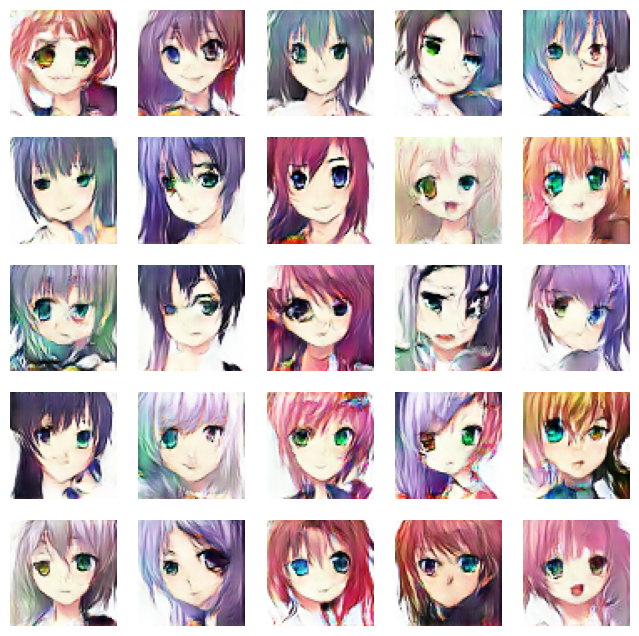

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6854 - g_loss: 0.8972 - d_accuracy: 0.5371 - g_accuracy: 0.1119
Epoch 30/30
673/674 [============================>.] - ETA: 0s - d_loss: 0.6816 - g_loss: 0.9077 - d_accuracy: 0.5483 - g_accuracy: 0.1049

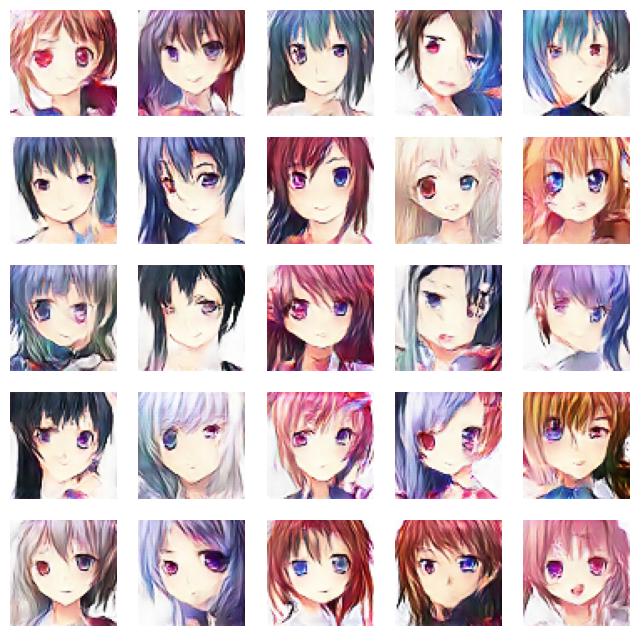

674/674 [==============================] - 45s 67ms/step - d_loss: 0.6816 - g_loss: 0.9077 - d_accuracy: 0.5483 - g_accuracy: 0.1049


In [22]:
# train the model
N_EPOCHS = 30
history = dcgan.fit(train_images, epochs=N_EPOCHS, callbacks=[DCGANMonitor()])

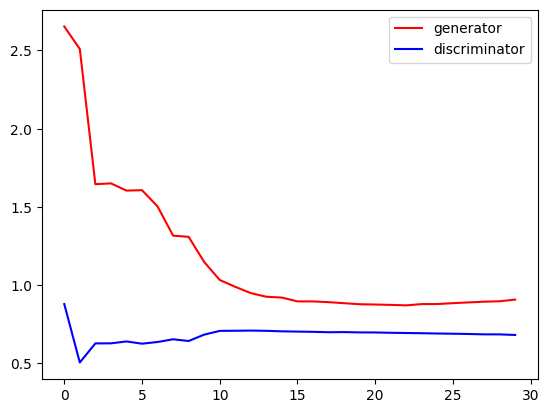

In [23]:
import matplotlib.pyplot as plt

plt.plot(history.history['g_loss'],color='red',label='generator')
plt.plot(history.history['d_loss'],color='blue',label='discriminator')
plt.legend()
plt.show()

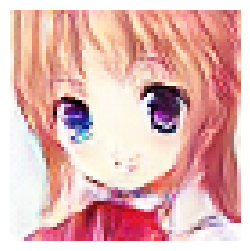

In [24]:
noise = tf.random.normal([1, 100])
fig = plt.figure(figsize=(3, 3))
# generate the image from noise
g_img = dcgan.generator(noise)
# denormalize the image
g_img = (g_img * 127.5) + 127.5
g_img.numpy()
img = array_to_img(g_img[0])
plt.imshow(img)
plt.axis('off')
plt.show()

In [25]:
!zip -r /content/anime_outputs.zip /content/drive/MyDrive/outputs

  adding: content/drive/MyDrive/outputs/ (stored 0%)
  adding: content/drive/MyDrive/outputs/epoch_008.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_025.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_011.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_016.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_022.png (deflated 1%)
  adding: content/drive/MyDrive/outputs/epoch_001.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_020.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_027.png (deflated 1%)
  adding: content/drive/MyDrive/outputs/epoch_003.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_018.png (deflated 1%)
  adding: content/drive/MyDrive/outputs/epoch_006.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_024.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_000.png (deflated 0%)
  adding: content/drive/MyDrive/outputs/epoch_005.png (deflated